# 🧠 Diplomado en Ciencia de Datos  
## 📦 Módulo 2: Almacenamiento y Preparación de Datos (Gestión de Datos)

---

### 📚 Práctica – Semana 2 
**Estudiante:** Bruno Joel Vásquez Gonzales  

**Fecha:** Abril 2025

**Código SIS:**  202000737

In [ ]:
import pyodbc
import dataprep
from scipy import stats
import numpy as np
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler

from sklearn.model_selection import train_test_split



In [ ]:
# Cadena de conexión a SQL Server usando autenticación de Windows
cnxn_str = (
            "Driver={ODBC Driver 17 for SQL Server};"
            "Server=LAPTOP-IM8EIRNS;"
            "Database=DataMartVentas;"
            "Trusted_Connection=yes;"
)
# Conexión
cnxn = pyodbc.connect(cnxn_str)

## 🎯 Objetivo

Predecir el **Ingreso Bruto** de un pedido en función de las siguientes variables:

- 🛒 **Producto**
- 👨‍💼 **Empleado**
- 🧍 **Cliente**
- 📅 **Fecha**

El objetivo es identificar patrones y relaciones entre estas variables para construir un modelo que permita estimar de forma precisa el ingreso generado por cada transacción.


In [ ]:
# Consulta para cargar datos del DataMart desde SQL Server
df_datamart = pd.read_sql('''
    SELECT 
        HV.IdVenta,
        HV.IdPedido,
        HV.Cantidad,
        HV.PrecioUnitario,
        HV.Descuento,
        HV.IngresoBruto,
        DP.NombreProducto,
        DC.NombreEmpresa AS Cliente,
        DC.Pais AS PaisCliente,
        DE.Nombres + ' ' + DE.Apellidos AS Empleado,
        DE.Cargo,
        DF.FechaCompleta,
        DF.Año,
        DF.Mes,
        DF.Dia,
        DF.Trimestre
    FROM HechosVentas HV
    JOIN DimProducto DP ON HV.IdProducto = DP.IdProducto
    JOIN DimCliente DC ON HV.IdCliente = DC.IdCliente
    JOIN DimEmpleado DE ON HV.IdEmpleado = DE.IdEmpleado
    JOIN DimFecha DF ON HV.IdFecha = DF.IdFecha
''', con=cnxn)

df_datamart.head()




C:\Users\Bruno\AppData\Local\Temp\ipykernel_28748\759580761.py:2: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_datamart = pd.read_sql('''


,IdVenta,IdPedido,Cantidad,PrecioUnitario,Descuento,IngresoBruto,NombreProducto,Cliente,PaisCliente,Empleado,Cargo,FechaCompleta,Año,Mes,Dia,Trimestre
0,32326,10248,12,14.0,0.0,168.0,Queso Cabrales,Vins et alcools Chevalier,France,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3
1,32327,10248,10,9.8,0.0,98.0,Singaporean Hokkien Fried Mee,Vins et alcools Chevalier,France,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3
2,32328,10248,5,34.8,0.0,174.0,Mozzarella di Giovanni,Vins et alcools Chevalier,France,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3
3,32329,10249,9,18.6,0.0,167.4,Tofu,Toms Spezialitäten,Germany,Michael Suyama,Sales Representative,1996-07-05,1996,7,5,3
4,32330,10249,40,42.4,0.0,1696.0,Manjimup Dried Apples,Toms Spezialitäten,Germany,Michael Suyama,Sales Representative,1996-07-05,1996,7,5,3


In [ ]:
# Información general del DataFrame y verificación de valores nulos
df_datamart.info()
df_datamart.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2155 entries, 0 to 2154
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   IdVenta         2155 non-null   int64  
 1   IdPedido        2155 non-null   int64  
 2   Cantidad        2155 non-null   int64  
 3   PrecioUnitario  2155 non-null   float64
 4   Descuento       2155 non-null   float64
 5   IngresoBruto    2155 non-null   float64
 6   NombreProducto  2155 non-null   object 
 7   Cliente         2155 non-null   object 
 8   PaisCliente     2155 non-null   object 
 9   Empleado        2155 non-null   object 
 10  Cargo           2155 non-null   object 
 11  FechaCompleta   2155 non-null   object 
 12  Año             2155 non-null   int64  
 13  Mes             2155 non-null   int64  
 14  Dia             2155 non-null   int64  
 15  Trimestre       2155 non-null   int64  
dtypes: float64(3), int64(7), object(6)
memory usage: 269.5+ KB


IdVenta           0
IdPedido          0
Cantidad          0
PrecioUnitario    0
Descuento         0
IngresoBruto      0
NombreProducto    0
Cliente           0
PaisCliente       0
Empleado          0
Cargo             0
FechaCompleta     0
Año               0
Mes               0
Dia               0
Trimestre         0
dtype: int64

In [ ]:
df_datamart.dtypes 

IdVenta             int64
IdPedido            int64
Cantidad            int64
PrecioUnitario    float64
Descuento         float64
IngresoBruto      float64
NombreProducto     object
Cliente            object
PaisCliente        object
Empleado           object
Cargo              object
FechaCompleta      object
Año                 int64
Mes                 int64
Dia                 int64
Trimestre           int64
dtype: object

In [ ]:
len(df_datamart)

2155

In [ ]:
# Eliminación de columnas que no aportan valor al análisis o que ya no se necesitan
columnas_a_eliminar = [
    "IdVenta", "IdPedido", "FechaCompleta", "Mes"
]
# Verifica que quedaron solo las relevantes
df_datamart.head()

,IdVenta,IdPedido,Cantidad,PrecioUnitario,Descuento,IngresoBruto,NombreProducto,Cliente,PaisCliente,Empleado,Cargo,FechaCompleta,Año,Mes,Dia,Trimestre
0,32326,10248,12,14.0,0.0,168.0,Queso Cabrales,Vins et alcools Chevalier,France,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3
1,32327,10248,10,9.8,0.0,98.0,Singaporean Hokkien Fried Mee,Vins et alcools Chevalier,France,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3
2,32328,10248,5,34.8,0.0,174.0,Mozzarella di Giovanni,Vins et alcools Chevalier,France,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3
3,32329,10249,9,18.6,0.0,167.4,Tofu,Toms Spezialitäten,Germany,Michael Suyama,Sales Representative,1996-07-05,1996,7,5,3
4,32330,10249,40,42.4,0.0,1696.0,Manjimup Dried Apples,Toms Spezialitäten,Germany,Michael Suyama,Sales Representative,1996-07-05,1996,7,5,3


# 📊 Análisis Bivariado

> El análisis bivariado permite examinar la relación entre dos variables, identificando patrones, correlaciones o dependencias estadísticas.

---

## 🎯 Objetivo

- Analizar la interacción entre dos variables.
- Identificar asociaciones o relaciones significativas.
- Apoyar modelos predictivos y exploratorios.

Realizaremos el análisis con Dataprep y de manera manual graficas creadas en base a criterio.

  0%|          | 0/2300 [00:00<?, ?it/s]

c:\Users\Bruno\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
c:\Users\Bruno\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
c:\Users\Bruno\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
c:\Users\Bruno\AppData\Local\Pr


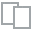
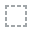
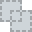
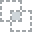
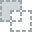
...
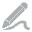
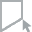
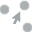
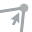
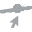

In [44]:
from dataprep.eda import create_report
create_report(df_datamart).show()

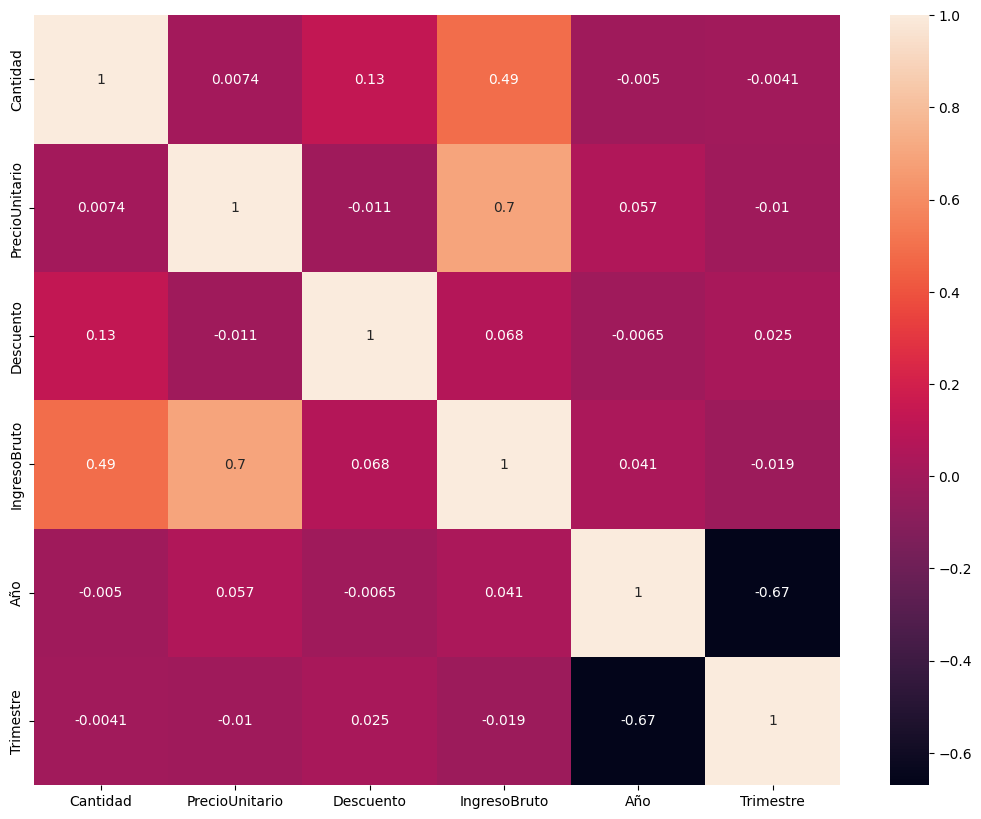

In [ ]:
# Mapa de calor (heatmap) de correlación
corr_df = df_datamart.corr(method='pearson')

plt.figure(figsize=(13, 10))
sns.heatmap(corr_df, annot=True)
plt.show()

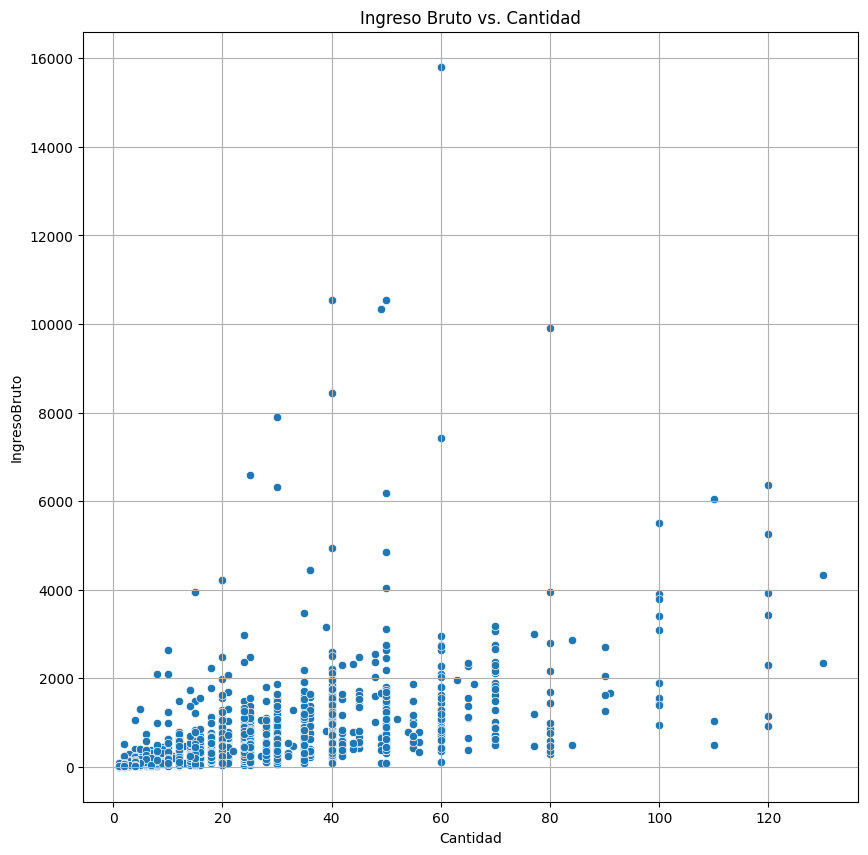

In [ ]:
# Diagrama de dispersión entre la cantidad vendida y el ingreso bruto
sns.scatterplot(data=df_datamart, x="Cantidad", y="IngresoBruto")
plt.title("Ingreso Bruto vs. Cantidad")
plt.grid(True)
plt.show()

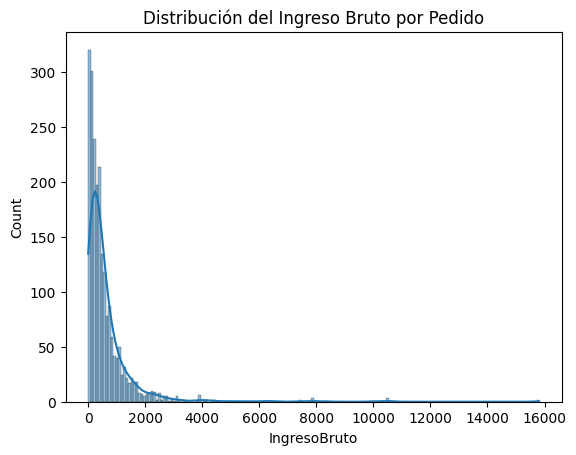

In [21]:
# Histograma del Ingreso Bruto por pedido

# Distribución del ingreso
sns.histplot(df_datamart["IngresoBruto"], kde=True)
plt.title("Distribución del Ingreso Bruto por Pedido")
plt.show()

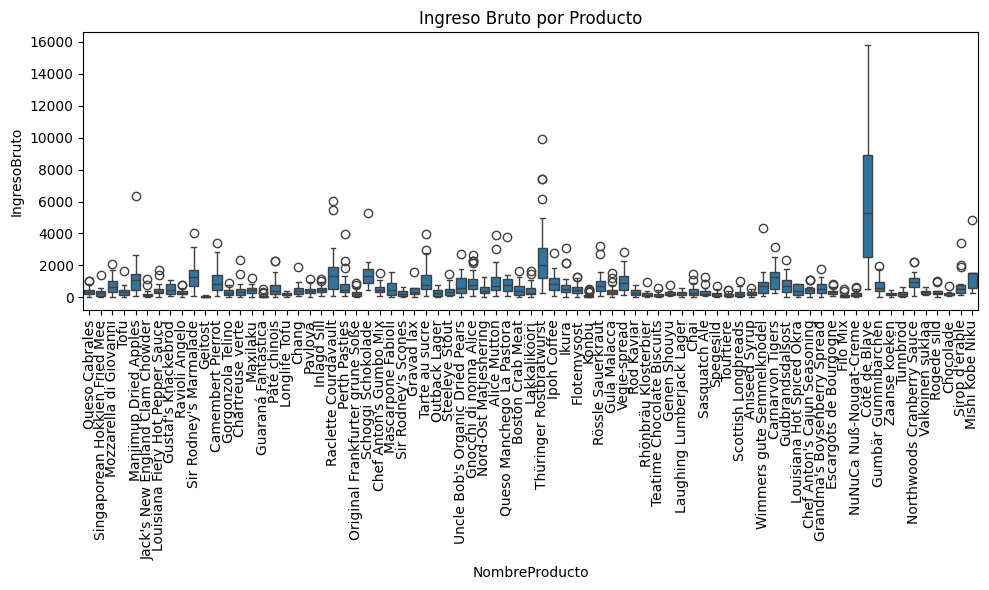

In [22]:
# Boxplot del ingreso por producto

# Ingreso por producto
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_datamart, x="NombreProducto", y="IngresoBruto")
plt.xticks(rotation=90)
plt.title("Ingreso Bruto por Producto")
plt.tight_layout()
plt.show()

In [ ]:
# Agrupamiento por nombre de producto
#  Calculamos el promedio (mean) de:
#     * Ingreso Bruto
#     * Cantidad vendida
#     * Precio Unitario
#     * Descuento aplicado
# Luego ordenamos los productos de mayor a menor Ingreso Bruto promedio

df_datamart.groupby("NombreProducto").agg({
    "IngresoBruto": "mean",
    "Cantidad": "mean",
    "PrecioUnitario": "mean",
    "Descuento": "mean"
}).sort_values("IngresoBruto", ascending=False)


,IngresoBruto,Cantidad,PrecioUnitario,Descuento
NombreProducto,,,,
Côte de Blaye,6249.341667,25.958333,245.933333,0.045833
Thüringer Rostbratwurst,2741.762500,23.312500,116.043125,0.064063
Mishi Kobe Niku,1765.400000,19.000000,93.120000,0.100000
Schoggi Schokolade,1692.388889,40.555556,40.966667,0.027778
Sir Rodney's Marmalade,1477.237500,19.562500,75.937500,0.046250
...,...,...,...,...
Tourtière,142.250000,20.972222,6.804167,0.072222
Konbu,130.860000,22.275000,5.760000,0.042500
Filo Mix,116.682759,17.241379,6.758621,0.041379


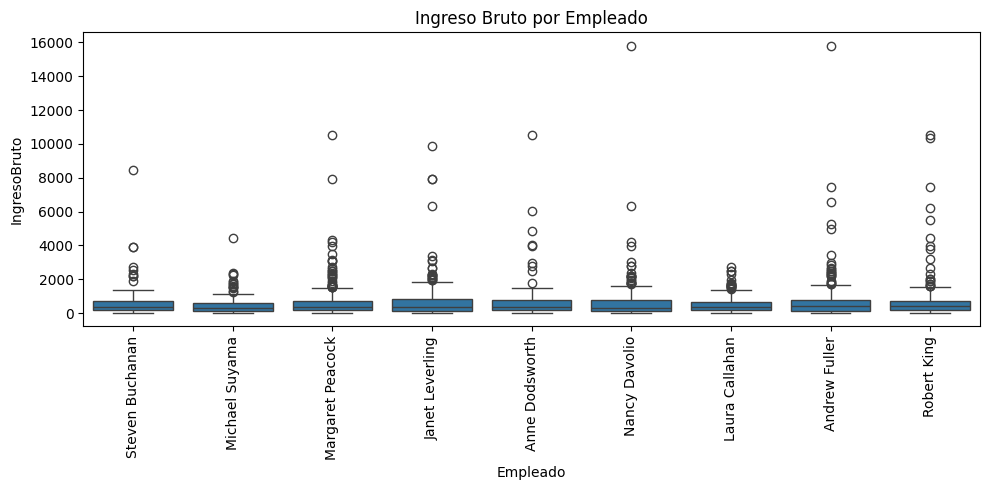

In [ ]:
# Boxplot del ingreso bruto por empleado
plt.figure(figsize=(10, 5))
sns.boxplot(data=df_datamart, x="Empleado", y="IngresoBruto")
plt.xticks(rotation=90)
plt.title("Ingreso Bruto por Empleado")
plt.tight_layout()
plt.show()



In [23]:
# Agrupamiento por empleado
# Calculamos el promedio (mean) de:
#     * Ingreso Bruto generado por cada empleado
#     * Cantidad de productos vendidos por cada empleado
# Luego ordenamos los empleados de mayor a menor Ingreso Bruto promedio


df_datamart.groupby("Empleado").agg({
    "IngresoBruto": "mean",
    "Cantidad": "mean"
}).sort_values("IngresoBruto", ascending=False)

,IngresoBruto,Cantidad
Empleado,,
Robert King,802.818125,26.443182
Anne Dodsworth,775.364486,24.953271
Andrew Fuller,737.548797,25.124481
Janet Leverling,663.711215,24.461059
Steven Buchanan,645.878205,25.948718
Margaret Peacock,595.684405,23.328571
Nancy Davolio,585.923797,22.643478
Laura Callahan,512.696269,22.742308
Michael Suyama,465.464881,20.994048


Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


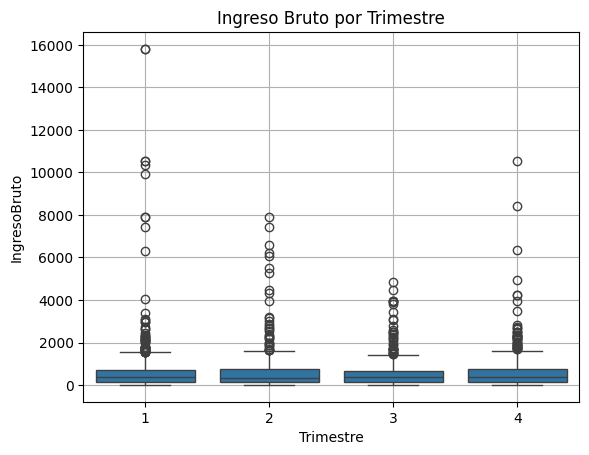

In [24]:
# Boxplot del Ingreso Bruto por Trimestre
sns.boxplot(data=df_datamart, x="Trimestre", y="IngresoBruto")
plt.title("Ingreso Bruto por Trimestre")
plt.grid(True)
plt.show()


In [25]:
# Calculamos el promedio (mean) de:
#     * Ingreso Bruto por trimestre
#     * Cantidad vendida por trimestre
#     * Descuento aplicado por trimestre
# Ordenamos los trimestres en orden creciente (1, 2, 3, 4)
df_datamart.groupby("Trimestre").agg({
    "IngresoBruto": "mean",
    "Cantidad": "mean",
    "Descuento": "mean"
}).sort_values("Trimestre")


,IngresoBruto,Cantidad,Descuento
Trimestre,,,
1,668.285743,24.457431,0.055195
2,622.236402,22.991870,0.054146
3,566.025261,23.052154,0.053175
4,634.365066,24.366730,0.061815


In [26]:
# Agrupamiento por cliente
# Calculamos el promedio (mean) de:
#     * Ingreso Bruto generado por cada cliente
#     * Cantidad promedio de productos comprados
#     * Descuento promedio recibido
# Ordenamos los clientes de mayor a menor según su Ingreso Bruto promedio
df_datamart.groupby("Cliente").agg({
    "IngresoBruto": "mean",
    "Cantidad": "mean",
    "Descuento": "mean"
}).sort_values("IngresoBruto", ascending=False)


,IngresoBruto,Cantidad,Descuento
Cliente,,,
QUICK-Stop,1366.085930,46.058140,0.069186
Simons bistro,1209.230000,25.200000,0.140000
Piccolo und mehr,1141.736957,27.130435,0.071739
Ernst Handel,1110.163529,44.539216,0.068137
Hanari Carnes,1065.660938,26.218750,0.067187
...,...,...,...
North/South,108.166667,5.000000,0.000000
Romero y tomillo,104.806429,6.500000,0.000000
Galería del gastrónomo,104.587500,5.250000,0.000000


In [ ]:
# Agrupamiento por país del cliente
# Calculamos el promedio (mean) de:
#     * Ingreso Bruto generado por país
#     * Cantidad promedio de productos vendidos por país
# Ordenamos los países de mayor a menor Ingreso Bruto promedio


df_datamart.groupby("PaisCliente").agg({
    "IngresoBruto": "mean",
    "Cantidad": "mean"
}).sort_values("IngresoBruto", ascending=False)


,IngresoBruto,Cantidad
PaisCliente,,
Austria,1115.973040,41.336000
Ireland,1042.134364,30.618182
Denmark,756.135870,25.434783
USA,748.769830,26.505682
Germany,745.855579,28.088415
Canada,737.788000,26.453333
Switzerland,633.067308,24.519231
Belgium,627.410357,24.857143
Sweden,613.646392,23.041237


In [74]:
df_datamart.columns

Index(['Cantidad', 'PrecioUnitario', 'Descuento', 'IngresoBruto',
       'NombreProducto', 'Cliente', 'PaisCliente', 'Empleado', 'Cargo', 'Año',
       'Dia', 'Trimestre'],
      dtype='object')

In [34]:
df_datamart.shape

(2155, 16)

### 🧹 Preparación del DataFrame para Machine Learning

---

### 🔎 Diferenciación de variables

- **Continuas:**  
  `PrecioUnitario`, `Descuento`, `IngresoBruto`

- **Discretas:**  
  `Cantidad`, `Año`

- **Categóricas nominales:**  
  `NombreProducto`, `Cliente`, `Empleado`, `Continente`

- **Categórica ordinal:**  
  `Cargo` (mapeado como `Puesto`)

---

### ⚙️ Métodos aplicados

- **MinMaxScaler:** Normalización de variables numéricas al rango [0,1].
- **Mapeo ordinal:** Transformación de `Cargo` a `Puesto`.
- **OneHotEncoding:** Aplicado a `Trimestre`, `Puesto` y variables categóricas.

---

### ✅ Validaciones realizadas

- Sin valores nulos en el DataFrame final.
- Un único `Trimestre` y `Puesto` por fila.
- Variables numéricas correctamente diferenciadas y normalizadas.

---

### 🎯 Resultado

DataFrame finalizado y listo para:
- Machine Learning
- Modelado predictivo
- Técnicas de clustering

**Nota:**  
Se preservaron los datos originales trabajando sobre una copia segura del DataFrame.

---


In [248]:
# Diccionario para mapear países a continentes
pais_a_continente = {
    'USA': 'América del Norte',
    'Brazil': 'América del Sur',
    'Argentina': 'América del Sur',
    'Canada': 'América del Norte',
    'Mexico': 'América del Norte',
    'Germany': 'Europa',
    'France': 'Europa',
    'UK': 'Europa',
    'Spain': 'Europa',
    'Italy': 'Europa',
    'Austria': 'Europa',
    'Sweden': 'Europa',
    'Finland': 'Europa',
    'Norway': 'Europa',
    'Denmark': 'Europa',
    'Portugal': 'Europa',
    'Poland': 'Europa',
    'Czech Republic': 'Europa',
    'Hungary': 'Europa',
    'Russia': 'Europa',
    'Belgium': 'Europa',          
    'Switzerland': 'Europa',       
    'Ireland': 'Europa',           
    'Venezuela': 'América del Sur',
    'China': 'Asia',
    'Japan': 'Asia',
    'South Korea': 'Asia',
    'India': 'Asia',
    'Australia': 'Oceanía',
    'New Zealand': 'Oceanía',
    'South Africa': 'África',
    'Egypt': 'África'
}

df_datamart['Continente'] = df_datamart['PaisCliente'].map(pais_a_continente)

# Eliminar PaisCliente
df_datamart = df_datamart.drop(columns=['PaisCliente'])


In [249]:
df_datamart.head()

,IdVenta,IdPedido,Cantidad,PrecioUnitario,Descuento,IngresoBruto,NombreProducto,Cliente,Empleado,Cargo,FechaCompleta,Año,Mes,Dia,Trimestre,Continente
0,32326,10248,12,14.0,0.0,168.0,Queso Cabrales,Vins et alcools Chevalier,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3,Europa
1,32327,10248,10,9.8,0.0,98.0,Singaporean Hokkien Fried Mee,Vins et alcools Chevalier,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3,Europa
2,32328,10248,5,34.8,0.0,174.0,Mozzarella di Giovanni,Vins et alcools Chevalier,Steven Buchanan,Sales Manager,1996-07-04,1996,7,4,3,Europa
3,32329,10249,9,18.6,0.0,167.4,Tofu,Toms Spezialitäten,Michael Suyama,Sales Representative,1996-07-05,1996,7,5,3,Europa
4,32330,10249,40,42.4,0.0,1696.0,Manjimup Dried Apples,Toms Spezialitäten,Michael Suyama,Sales Representative,1996-07-05,1996,7,5,3,Europa


In [253]:
# Crear una copia del DataFrame para trabajar el preprocesamiento
df_ml = df_datamart.copy()


In [254]:
# Definimos las variables continuas y discretas
scaler = MinMaxScaler()
variables_continuas = ['PrecioUnitario', 'Descuento', 'IngresoBruto']
variables_discretas = ['Cantidad', 'Año']

# Aplicamos escalado Min-Max a todas las variables numéricas seleccionadas
df_ml[variables_continuas + variables_discretas] = scaler.fit_transform(df_ml[variables_continuas + variables_discretas])


In [255]:
# Definimos las variables continuas y discretas
scaler = MinMaxScaler()
variables_continuas = ['PrecioUnitario', 'Descuento', 'IngresoBruto']
variables_discretas = ['Cantidad', 'Año']

# Aplicamos escalado Min-Max a todas las variables numéricas seleccionadas
df_ml[variables_continuas + variables_discretas] = scaler.fit_transform(df_ml[variables_continuas + variables_discretas])

In [256]:
# 1. Mapear Cargo a Puesto numérico
orden_cargo = {
    'Sales Representative': 1,
    'Inside Sales Coordinator': 2,
    'Sales Manager': 3,
    'Vice President, Sales': 4
}
df_ml['Cargo'] = df_ml['Cargo'].apply(lambda x: str(x).strip() if pd.notnull(x) else x)
df_ml['Puesto'] = df_ml['Cargo'].map(orden_cargo)


In [257]:
#  One-Hot Encoding para Trimestre (si existe)
if 'Trimestre' in df_ml.columns:
    df_trimestre = pd.get_dummies(df_ml['Trimestre'], prefix='Trimestre')
    df_ml = pd.concat([df_ml.drop(columns=['Trimestre']), df_trimestre], axis=1)


In [ ]:
# One-Hot Encoding para Puesto
df_puesto = pd.get_dummies(df_ml['Puesto'], prefix='Puesto')
df_ml = pd.concat([df_ml.drop(columns=['Puesto']), df_puesto], axis=1)


In [259]:
# One-Hot Encoding para variables categóricas
variables_categoricas = ['NombreProducto', 'Cliente', 'Empleado', 'Continente']
df_categoricas = pd.get_dummies(df_ml[variables_categoricas], drop_first=True)


In [ ]:
# Crear df_ml_final
df_ml_final = pd.concat([
    df_ml[['Cantidad', 'PrecioUnitario', 'Descuento', 'IngresoBruto', 'Año']],
    df_puesto,          
    df_trimestre,       
    df_categoricas      
], axis=1)

In [262]:
# 6. Exportar
df_ml_final.to_csv('DataMart_Procesado.csv', index=False, encoding='utf-8')


In [263]:
print(df_ml_final.shape)
df_ml_final.head()


(2155, 187)


,Cantidad,PrecioUnitario,Descuento,IngresoBruto,Año,Puesto_1,Puesto_2,Puesto_3,Puesto_4,Trimestre_1,...,Empleado_Anne Dodsworth,Empleado_Janet Leverling,Empleado_Laura Callahan,Empleado_Margaret Peacock,Empleado_Michael Suyama,Empleado_Nancy Davolio,Empleado_Robert King,Empleado_Steven Buchanan,Continente_América del Sur,Continente_Europa
0,0.085271,0.045889,0.0,0.010326,0.0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
1,0.069767,0.029828,0.0,0.005897,0.0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
2,0.031008,0.125430,0.0,0.010705,0.0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,1
3,0.062016,0.063480,0.0,0.010288,0.0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
4,0.302326,0.154493,0.0,0.107003,0.0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1


## 🎯 Objetivo

---

Finalmente, se cuenta con un DataFrame listo para un posterior análisis de Machine Learning, con el objetivo de:

### 🔮 Predecir el **Ingreso Bruto** de un pedido en función de:

- 🛒 **Producto**
- 👨‍💼 **Empleado**
- 🧍 **Cliente**
- 📅 **Fecha**

---

**Nota:**  
Se garantiza que las variables relevantes fueron correctamente preparadas y el DataFrame mantiene la integridad necesaria para modelados predictivos.
